<a href="https://colab.research.google.com/github/LavanyaKethavath/Adversarial-Image-Colorization-A-GAN-Based-Approach-for-Converting-Grayscale-Images-to-Vivid-Color/blob/main/MiniProject.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install fastai==2.7

INFO: pip is looking at multiple versions of torchvision to determine which version is compatible with other requirements. This could take a while.
INFO: pip is still looking at multiple versions of torchvision to determine which version is compatible with other requirements. This could take a while.
INFO: This is taking longer than usual. You might need to provide the dependency resolver with stricter constraints to reduce runtime. See https://pip.pypa.io/warnings/backtracking for guidance. If you want to abort this run, press Ctrl + C.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 213.6/213.6 kB 581.0 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.3/61.3 kB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 750.6/750.6 MB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.0/21.0 MB 45.7 MB/s eta 0:00:00
  Attempting uninstall: torch
    Found existing installation: torch 2.5.1+cu121
    Uninstalling torch-2.5.1+cu121:
      Successfully u

In [ ]:
from fastai.data.external import untar_data, URLs
coco_path = untar_data(URLs.COCO_SAMPLE)
coco_path = str(coco_path) + "/train_sample"

In [ ]:
path = coco_path

In [ ]:
import glob
import numpy as np
import os

In [ ]:
paths = glob.glob(path + "/*.jpg")
np.random.seed(123)
paths_subset = np.random.choice(paths, 10000, replace=False)
rand_idxs = np.random.permutation(10000)
train_idxs = rand_idxs[:8000]
val_idxs = rand_idxs[8000:]
train_paths = paths_subset[train_idxs]
val_paths = paths_subset[val_idxs]

In [ ]:
len(train_paths)

8000

In [ ]:
from matplotlib import pyplot as plt
from PIL import Image

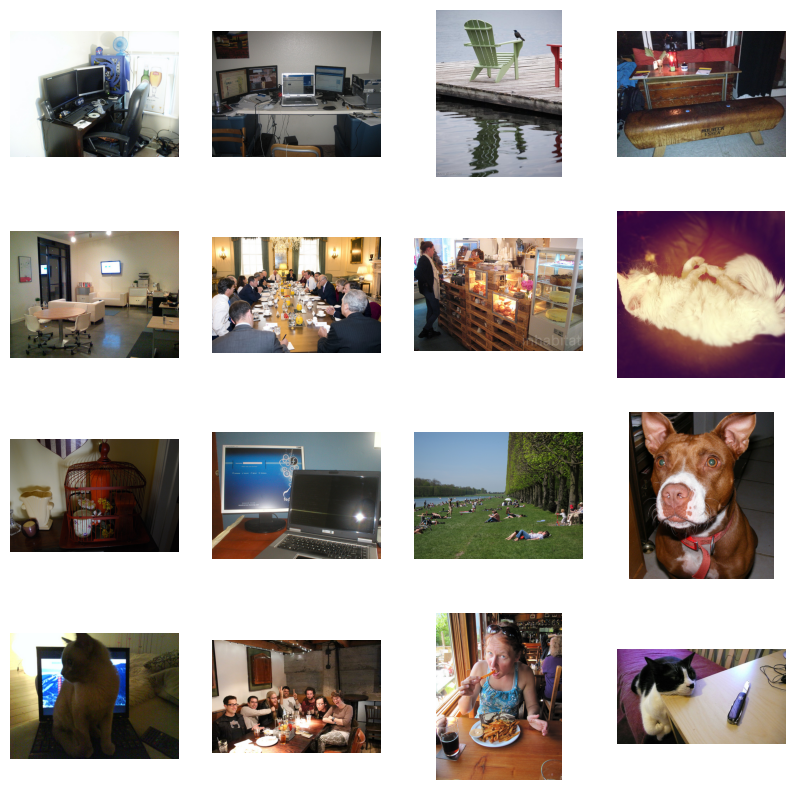

In [ ]:
_, axes = plt.subplots(4, 4, figsize=(10, 10))
for ax, img_path in zip(axes.flatten(), train_paths):
    ax.imshow(Image.open(img_path))
    ax.axis("off")

In [ ]:
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from skimage.color import rgb2lab, lab2rgb

In [ ]:
SIZE = 256

In [ ]:
class ColorizationDataset(Dataset):
    def __init__(self, paths, split="train"):
        if split == "train":
            self.transforms = transforms.Compose([
                transforms.Resize((SIZE, SIZE), Image.BICUBIC),
                transforms.RandomHorizontalFlip(),
            ])
        elif split == "val":
            self.transforms = transforms.Resize((SIZE, SIZE), Image.BICUBIC)
        self.split = split
        self.size = SIZE
        self.paths = paths

    def __getitem__(self, idx):
        img = Image.open(self.paths[idx]).convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        img_lab = rgb2lab(img).astype("float32")
        img_lab = transforms.ToTensor()(img_lab)
        L = img_lab[[0], ...] / 50. - 1.
        ab = img_lab[[1, 2], ...] / 110.
        return {"L": L, "ab": ab}

    def __len__(self):
        return len(self.paths)

In [ ]:
def make_dataloaders(batch_size=16, n_workers=4, pin_memory=True, **kwargs):
    dataset = ColorizationDataset(**kwargs)
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers, pin_memory=pin_memory)
    return dataloader

In [ ]:
train_dl = make_dataloaders(paths=train_paths, split="train")
val_dl = make_dataloaders(paths=val_paths, split="val")

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


In [ ]:
data = next(iter(train_dl))

In [ ]:
print(len(train_dl), len(val_dl))

500 125


In [ ]:
print(data["L"].shape, data["ab"].shape)

torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])


In [ ]:
import torch
from torch import nn, optim

In [ ]:
class UnetBlock(nn.Module):
    def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False, innermost=False, outermost=False):
        super().__init__()
        self.outermost = outermost
        if input_c is None:
            input_c = nf
        downconv = nn.Conv2d(input_c, ni, kernel_size=4, stride=2, padding=1, bias=False)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = nn.BatchNorm2d(ni)
        uprelu = nn.ReLU(True)
        upnorm = nn.BatchNorm2d(nf)
        if outermost:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4, stride=2, padding=1)
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4, stride=2, padding=1, bias=False)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4, stride=2, padding=1, bias=False)
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]
            if dropout:
                up += [nn.Dropout(0.5)]
            model = down + [submodule] + up
        self.model = nn.Sequential(*model)

    def forward(self, x):
        if self.outermost:
            return self.model(x)
        return torch.cat([x, self.model(x)], 1)

In [ ]:
class Unet(nn.Module):
    def __init__(self, input_c=1, output_c=1, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)

    def forward(self, x):
        return self.model(x)

In [ ]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s = 1 if i == (n_down - 1) else 2) for i in range(n_down)]
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s = 1, norm=False, act=False)]
        self.model = nn.Sequential(*model)

    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True):
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]
        if norm:
            layers += [nn.BatchNorm2d(nf)]
        if act:
            layers += [nn.LeakyReLU(0.2, True)]
        return nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)

In [ ]:
PatchDiscriminator(3)

PatchDiscriminator(
  (model): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (3): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (

In [ ]:
discriminator = PatchDiscriminator(3)
dummy_input = torch.randn(16, 3, 256, 256)
out = discriminator(dummy_input)
out.shape

torch.Size([16, 1, 30, 30])

In [ ]:
class GANLoss(nn.Module):
    def __init__(self, gan_mode="vanilla", real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer("real_label", torch.tensor(real_label))
        self.register_buffer("fake_label", torch.tensor(fake_label))
        if gan_mode == "vanilla":
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == "lsgan":
            self.loss = nn.MSELoss()

    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)

    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

In [ ]:
def init_weights(net, init="norm", gain=0.02):
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, "weight") and "Conv" in classname:
            if init == "norm":
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == "xavier":
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == "kaiming":
                nn.init.kaiming_normal_(m.weight.data, a=0, mode="fan_in")
            if hasattr(m, "bias") and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif "BatchNorm2d" in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)

    net.apply(init_func)
    print(f"Model initialized with {init} initialization")
    return net

In [ ]:
def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

In [ ]:
class MainModel(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4, beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1
        if net_G is None:
            self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GANLoss(gan_mode="vanilla").to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))

    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad

    def setup_input(self, data):
        self.L = data["L"].to(self.device)
        self.ab = data["ab"].to(self.device)

    def forward(self):
        self.fake_color = self.net_G(self.L)

    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()

    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()

    def optimize(self):
        self.forward()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()
        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

In [ ]:
class AverageMeter:
    def __init__(self):
        self.reset()

    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3

    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

In [ ]:
def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    return {"loss_D_fake": loss_D_fake, "loss_D_real": loss_D_real, "loss_D": loss_D, "loss_G_GAN": loss_G_GAN, "loss_G_L1": loss_G_L1, "loss_G": loss_G}

In [ ]:
def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

In [ ]:
def lab_to_rgb(L, ab):
    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)

In [ ]:
import time
from tqdm.notebook import tqdm

In [ ]:
def visualize(model, data, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap="gray")
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")

In [ ]:
def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

In [ ]:
def train_model(model, train_dl, epochs, display_every=200):
    data = next(iter(val_dl))
    for e in range(epochs):
        loss_meter_dict = create_loss_meters()
        i = 0
        for data in tqdm(train_dl):
            model.setup_input(data)
            model.optimize()
            update_losses(model, loss_meter_dict, count=data["L"].size(0))
            i += 1
            if i % display_every == 0:
                print(f"\nEpoch {e + 1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                log_results(loss_meter_dict)
                visualize(model, data, save=False)

In [ ]:
model = MainModel()

Model initialized with norm initialization
Model initialized with norm initialization


In [ ]:
train_model(model, train_dl, 5)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


  0%|          | 0/500 [00:00<?, ?it/s]

In [ ]:
torch.save(model, "./model-1.pth")

In [ ]:
from fastai.vision.learner import create_body
from torchvision.models.resnet import resnet18
from fastai.vision.models.unet import DynamicUnet

In [ ]:
def build_res_unet(n_input=1, n_output=2, size=256):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    body = create_body(resnet18, pretrained=True, n_in=n_input, cut=-2)
    net_G = DynamicUnet(body, n_output, (size, size)).to(device)
    return net_G

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
def pretrain_generator(net_G, train_dl, opt, criterion, epochs):
    for e in range(epochs):
        loss_meter = AverageMeter()
        for data in tqdm(train_dl):
            L, ab = data['L'].to(device), data['ab'].to(device)
            preds = net_G(L)
            loss = criterion(preds, ab)
            opt.zero_grad()
            loss.backward()
            opt.step()

            loss_meter.update(loss.item(), L.size(0))

        print(f"Epoch {e + 1}/{epochs}")
        print(f"L1 Loss: {loss_meter.avg:.5f}")

net_G = build_res_unet(n_input=1, n_output=2, size=256)
opt = optim.Adam(net_G.parameters(), lr=1e-4)
criterion = nn.L1Loss()
pretrain_generator(net_G, train_dl, opt, criterion, 5)
torch.save(net_G.state_dict(), "res18-unet.pt")

Model initialized with norm initialization


  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 1/20
Iteration 200/500
loss_D_fake: 0.53083
loss_D_real: 0.54016
loss_D: 0.53550
loss_G_GAN: 1.38057
loss_G_L1: 8.94143
loss_G: 10.32199


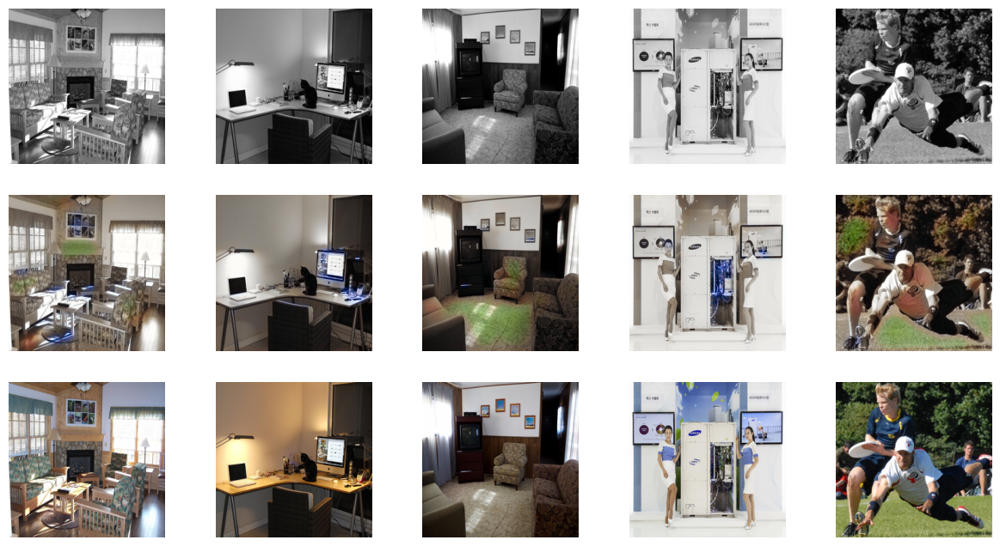


Epoch 1/20
Iteration 400/500
loss_D_fake: 0.50852
loss_D_real: 0.52750
loss_D: 0.51801
loss_G_GAN: 1.44744
loss_G_L1: 9.20956
loss_G: 10.65699


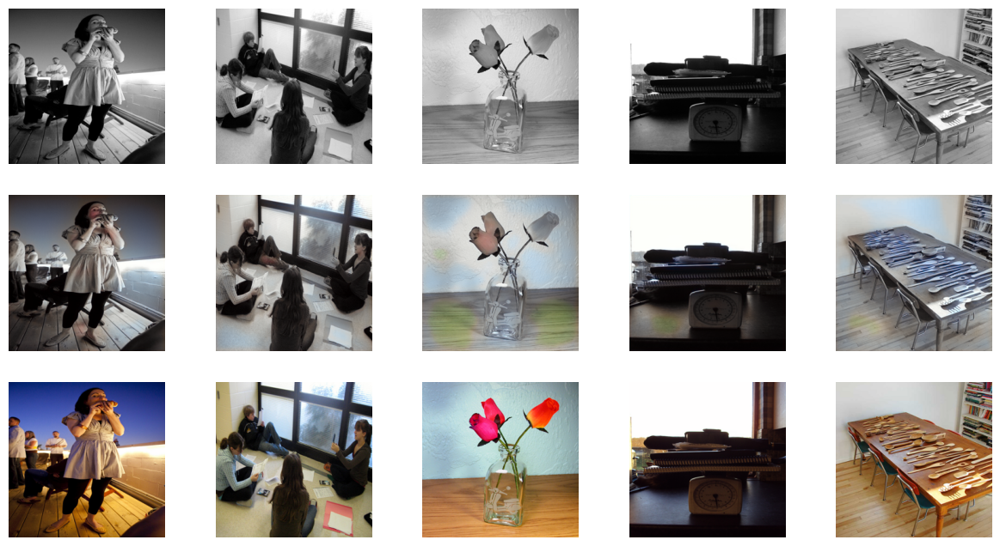

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 2/20
Iteration 200/500
loss_D_fake: 0.53064
loss_D_real: 0.57044
loss_D: 0.55054
loss_G_GAN: 1.35315
loss_G_L1: 9.91549
loss_G: 11.26864


<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 27 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 20 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 3 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


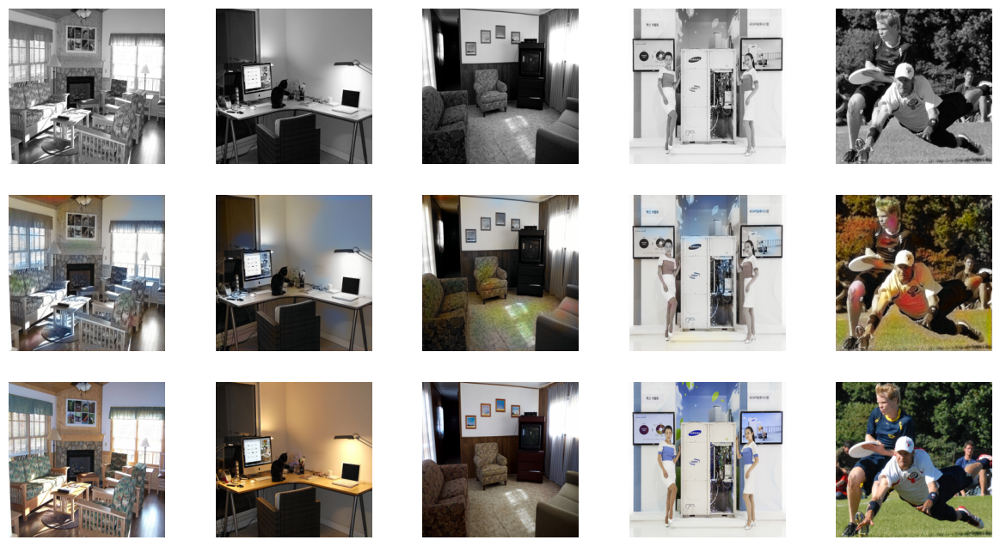


Epoch 2/20
Iteration 400/500
loss_D_fake: 0.53302
loss_D_real: 0.56807
loss_D: 0.55054
loss_G_GAN: 1.30038
loss_G_L1: 9.83575
loss_G: 11.13613


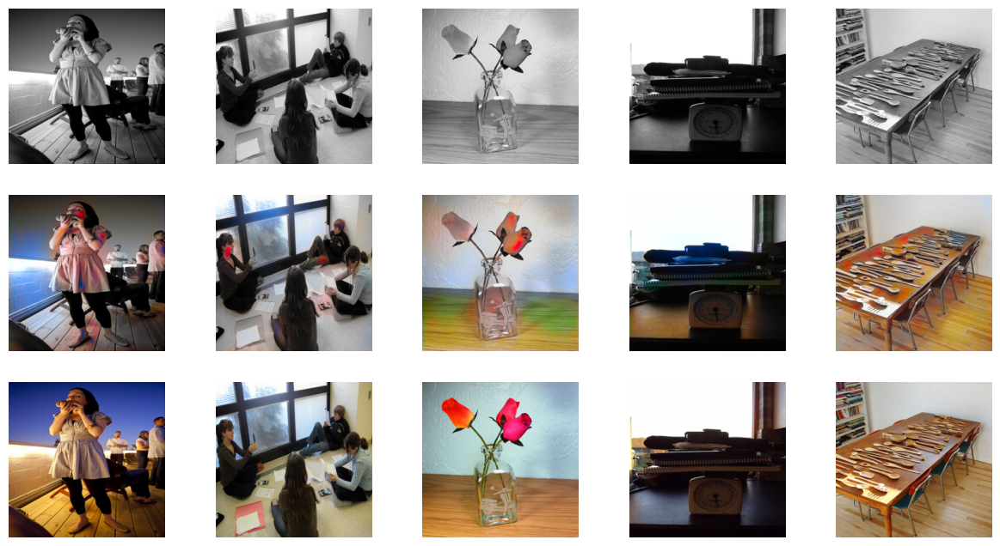

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 3/20
Iteration 200/500
loss_D_fake: 0.53567
loss_D_real: 0.58461
loss_D: 0.56014
loss_G_GAN: 1.23144
loss_G_L1: 9.83272
loss_G: 11.06416


<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 2 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


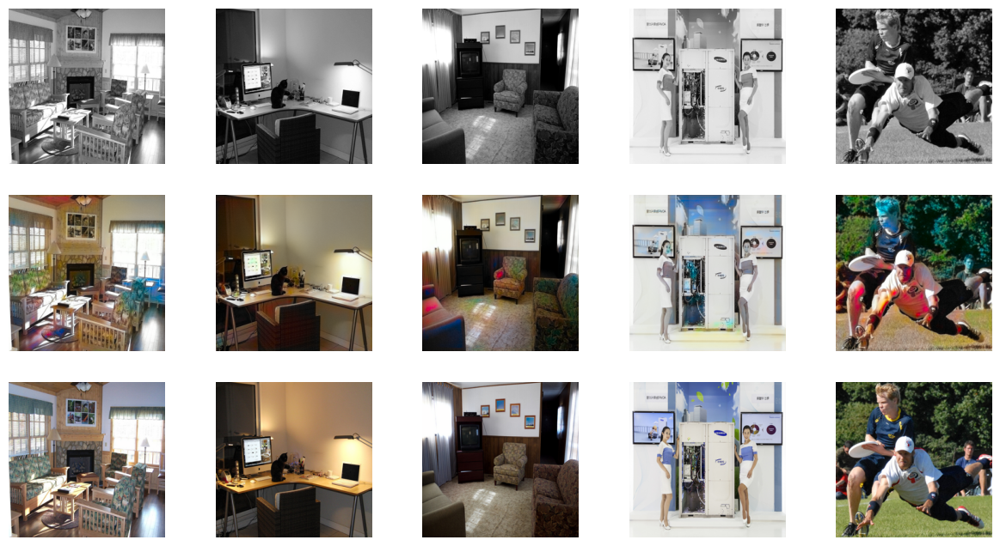


Epoch 3/20
Iteration 400/500
loss_D_fake: 0.55208
loss_D_real: 0.59034
loss_D: 0.57121
loss_G_GAN: 1.19054
loss_G_L1: 9.77506
loss_G: 10.96560


<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 7 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 198 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 13 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 145 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 62 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


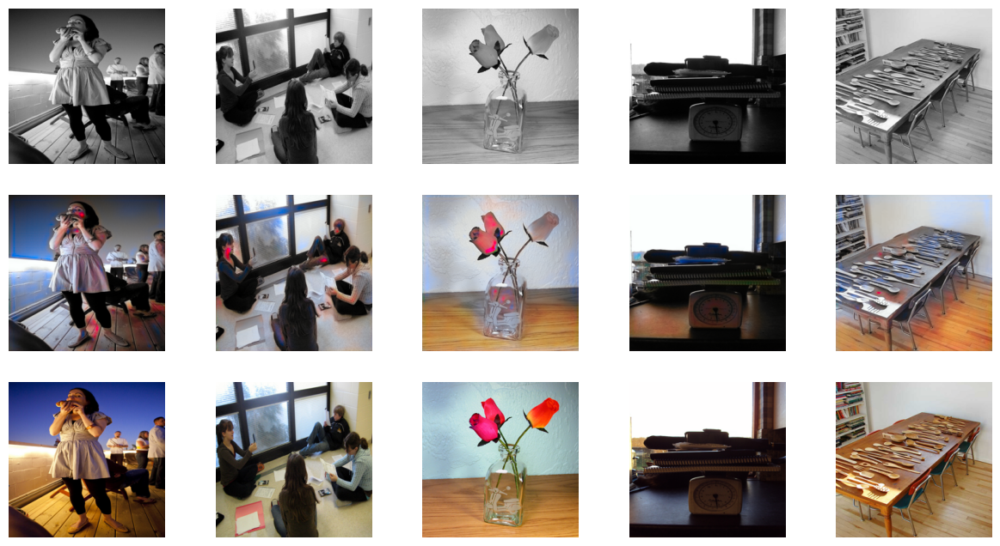

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 4/20
Iteration 200/500
loss_D_fake: 0.54245
loss_D_real: 0.59516
loss_D: 0.56881
loss_G_GAN: 1.18088
loss_G_L1: 9.69065
loss_G: 10.87154


<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 11 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 16 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 14 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 9 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 51 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-30-6769f52bf0eb>:7: UserWarning: Con

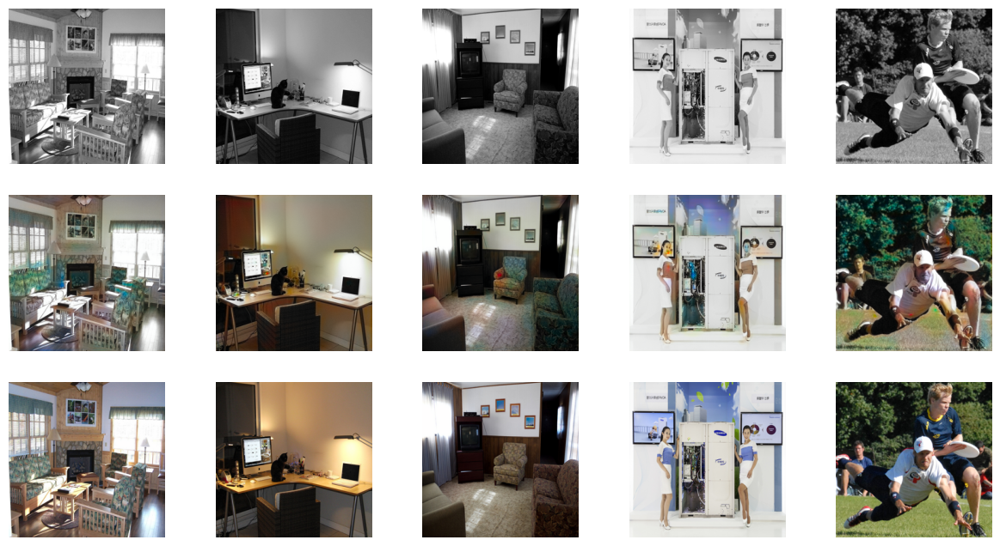


Epoch 4/20
Iteration 400/500
loss_D_fake: 0.55031
loss_D_real: 0.59513
loss_D: 0.57272
loss_G_GAN: 1.16640
loss_G_L1: 9.64300
loss_G: 10.80940


<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 1 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 277 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


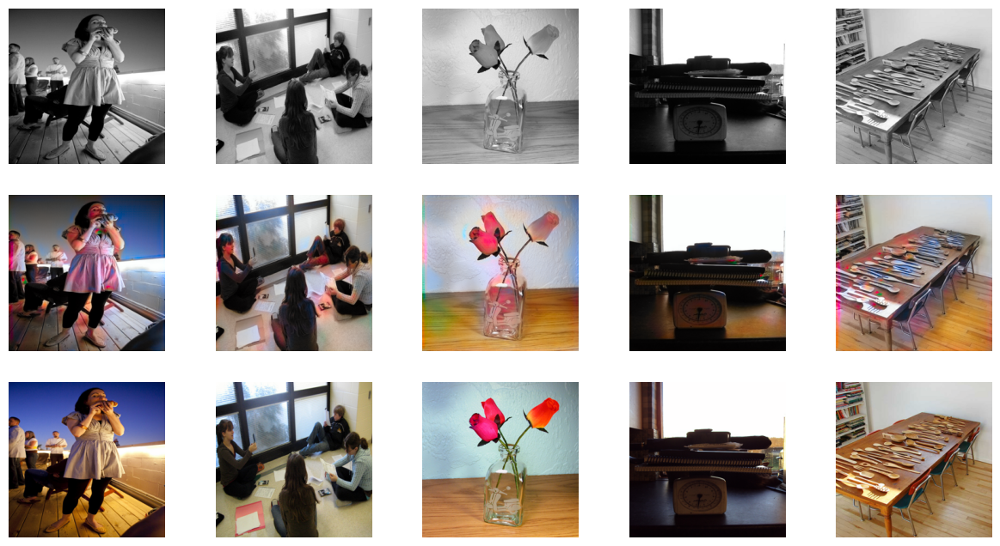

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 5/20
Iteration 200/500
loss_D_fake: 0.55776
loss_D_real: 0.61104
loss_D: 0.58440
loss_G_GAN: 1.12458
loss_G_L1: 9.60614
loss_G: 10.73072


<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 4 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 6 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


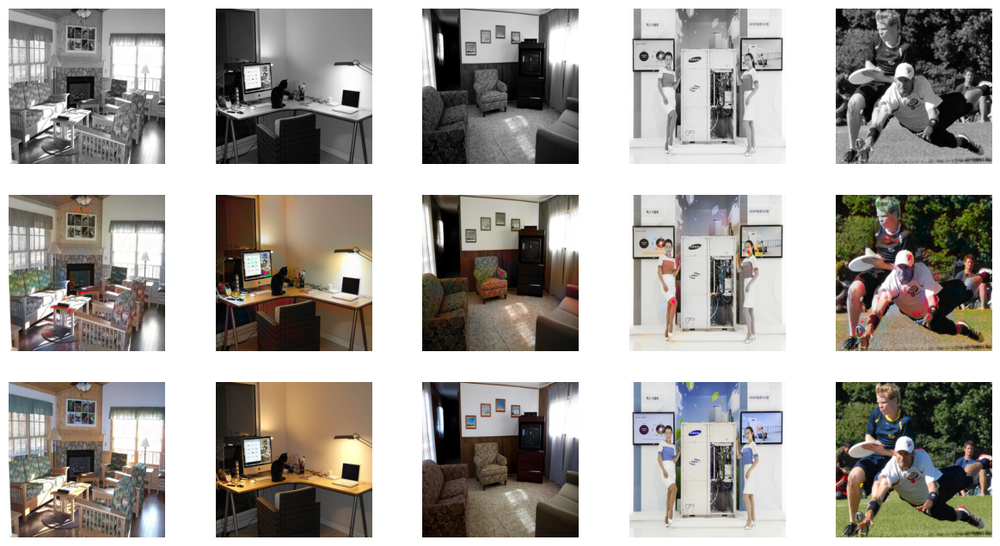


Epoch 5/20
Iteration 400/500
loss_D_fake: 0.56531
loss_D_real: 0.60970
loss_D: 0.58750
loss_G_GAN: 1.10119
loss_G_L1: 9.53208
loss_G: 10.63327


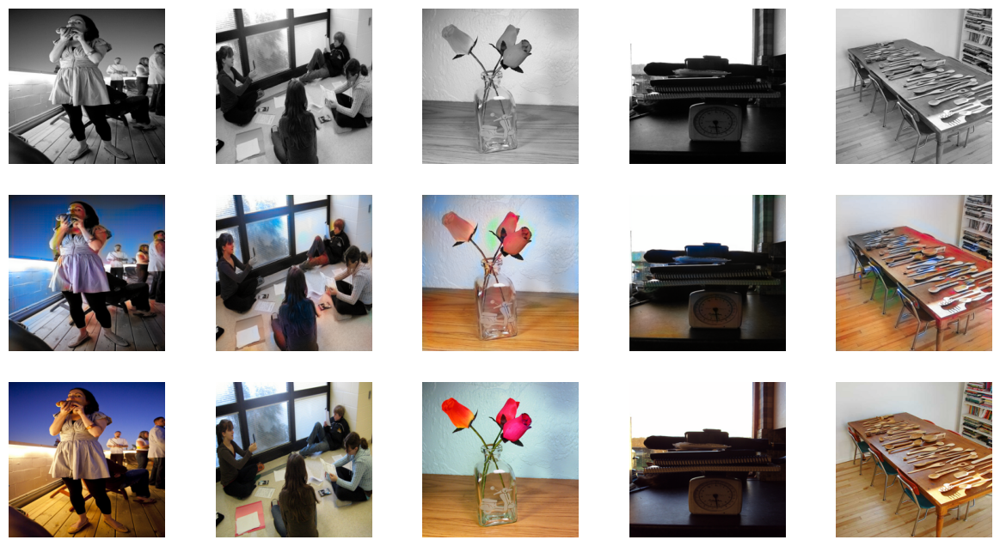

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 6/20
Iteration 200/500
loss_D_fake: 0.56889
loss_D_real: 0.61939
loss_D: 0.59414
loss_G_GAN: 1.08566
loss_G_L1: 9.40967
loss_G: 10.49533


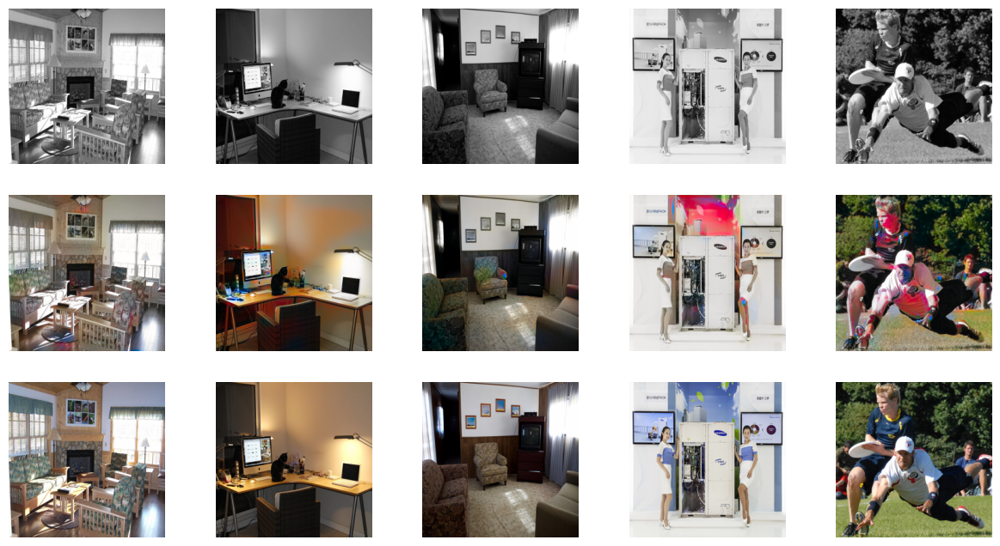


Epoch 6/20
Iteration 400/500
loss_D_fake: 0.57596
loss_D_real: 0.61716
loss_D: 0.59656
loss_G_GAN: 1.07663
loss_G_L1: 9.35784
loss_G: 10.43447


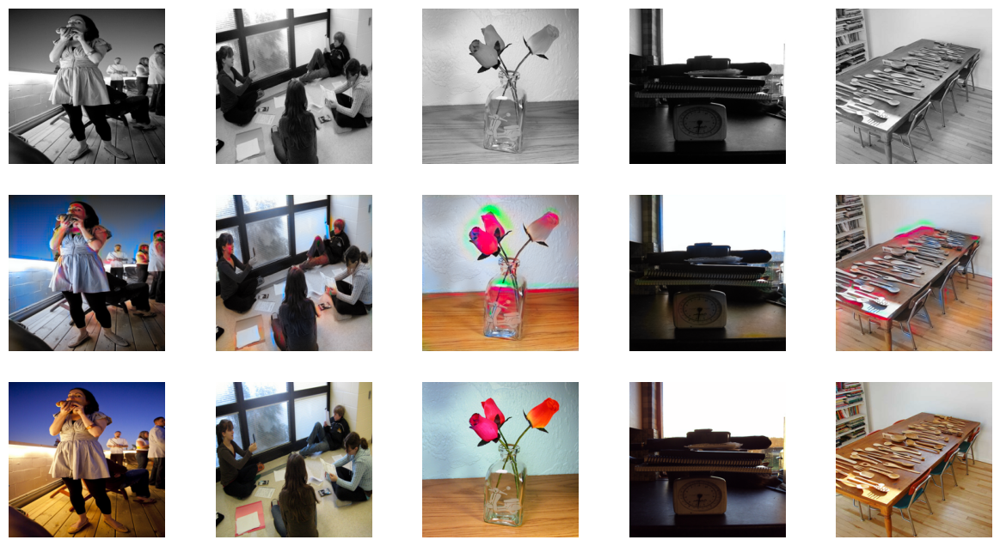

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 7/20
Iteration 200/500
loss_D_fake: 0.57387
loss_D_real: 0.63022
loss_D: 0.60204
loss_G_GAN: 1.05037
loss_G_L1: 9.16636
loss_G: 10.21673


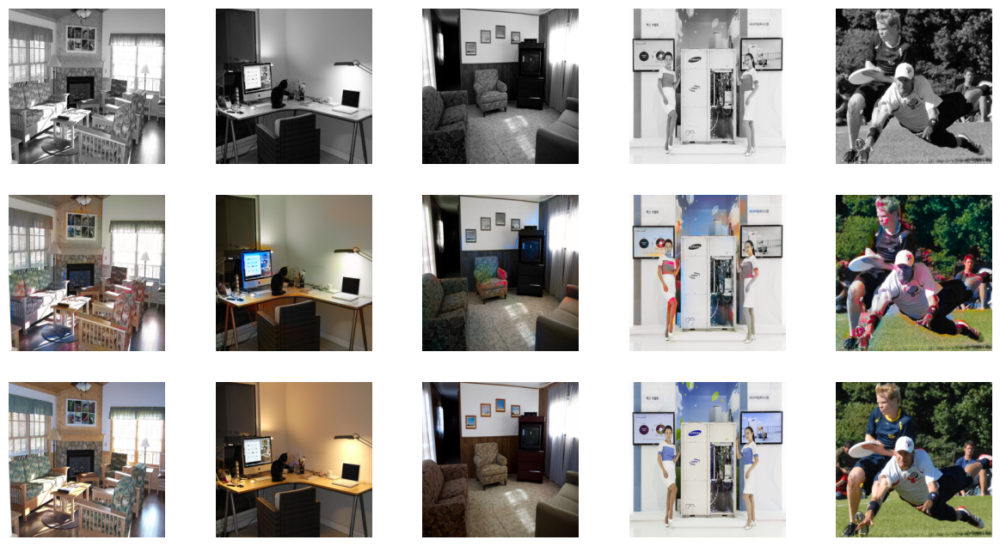


Epoch 7/20
Iteration 400/500
loss_D_fake: 0.57917
loss_D_real: 0.62556
loss_D: 0.60236
loss_G_GAN: 1.04177
loss_G_L1: 9.14571
loss_G: 10.18749


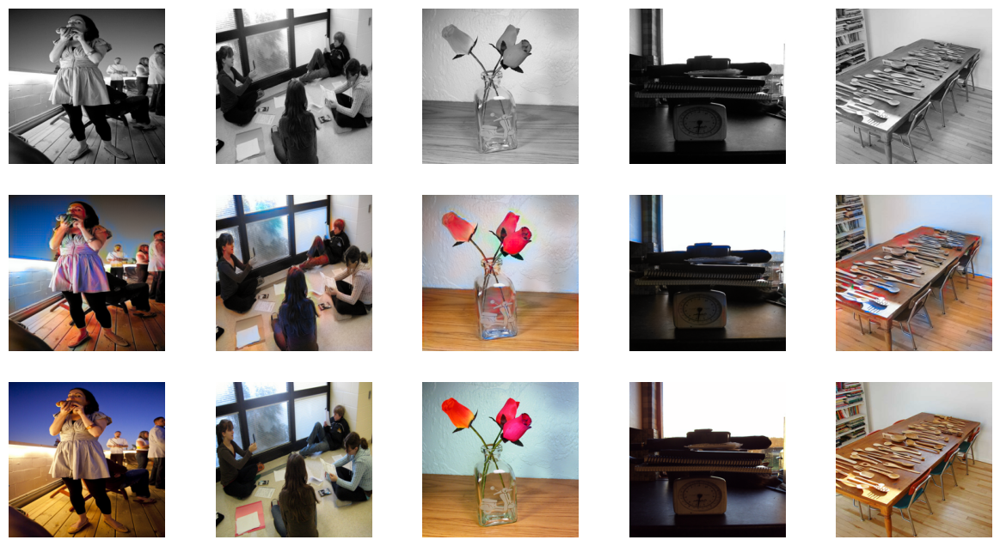

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 8/20
Iteration 200/500
loss_D_fake: 0.58250
loss_D_real: 0.63308
loss_D: 0.60779
loss_G_GAN: 1.03987
loss_G_L1: 9.00227
loss_G: 10.04214


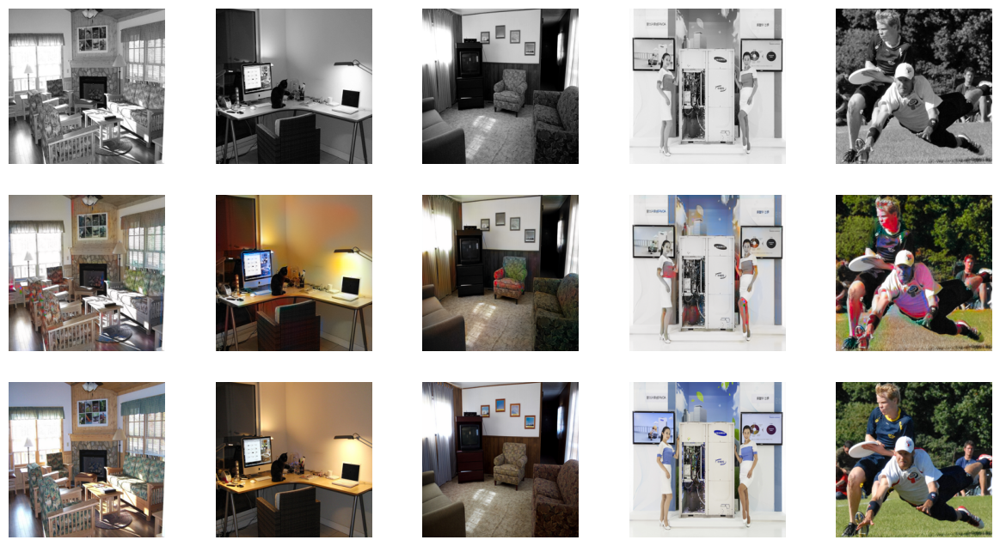


Epoch 8/20
Iteration 400/500
loss_D_fake: 0.58564
loss_D_real: 0.63007
loss_D: 0.60785
loss_G_GAN: 1.02576
loss_G_L1: 8.94008
loss_G: 9.96584


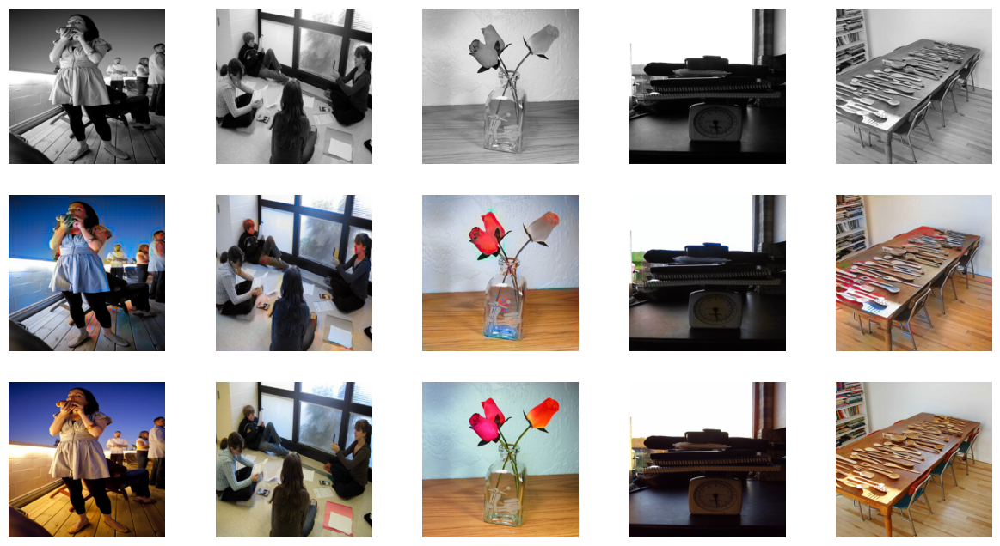

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 9/20
Iteration 200/500
loss_D_fake: 0.58478
loss_D_real: 0.63522
loss_D: 0.61000
loss_G_GAN: 1.02137
loss_G_L1: 8.80081
loss_G: 9.82218


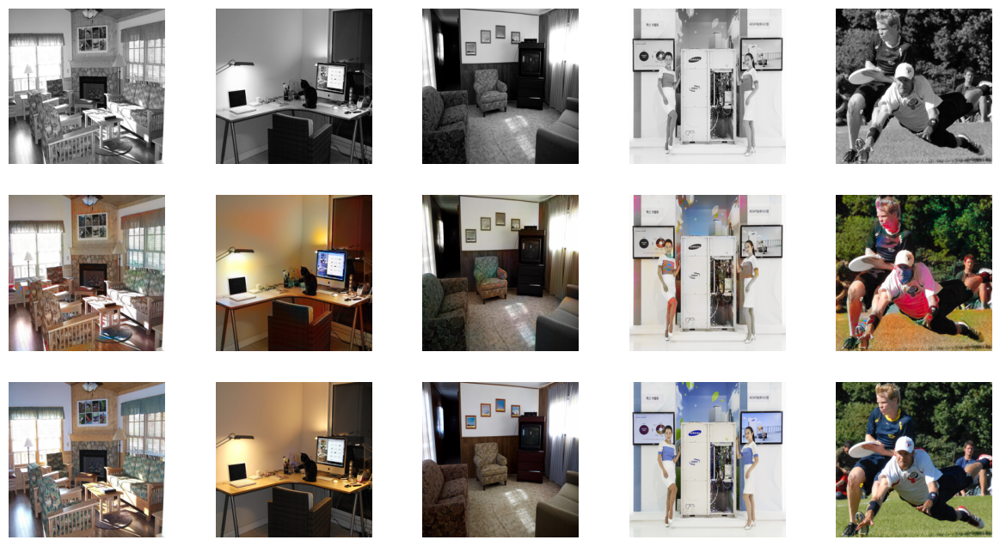


Epoch 9/20
Iteration 400/500
loss_D_fake: 0.58768
loss_D_real: 0.62811
loss_D: 0.60789
loss_G_GAN: 1.01245
loss_G_L1: 8.74257
loss_G: 9.75502


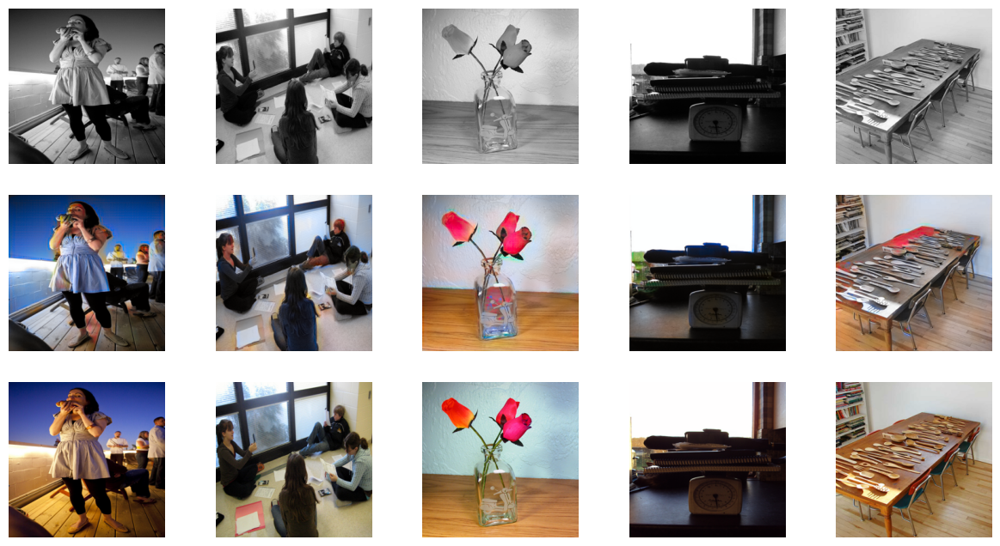

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 10/20
Iteration 200/500
loss_D_fake: 0.58342
loss_D_real: 0.63558
loss_D: 0.60950
loss_G_GAN: 1.02456
loss_G_L1: 8.60702
loss_G: 9.63158


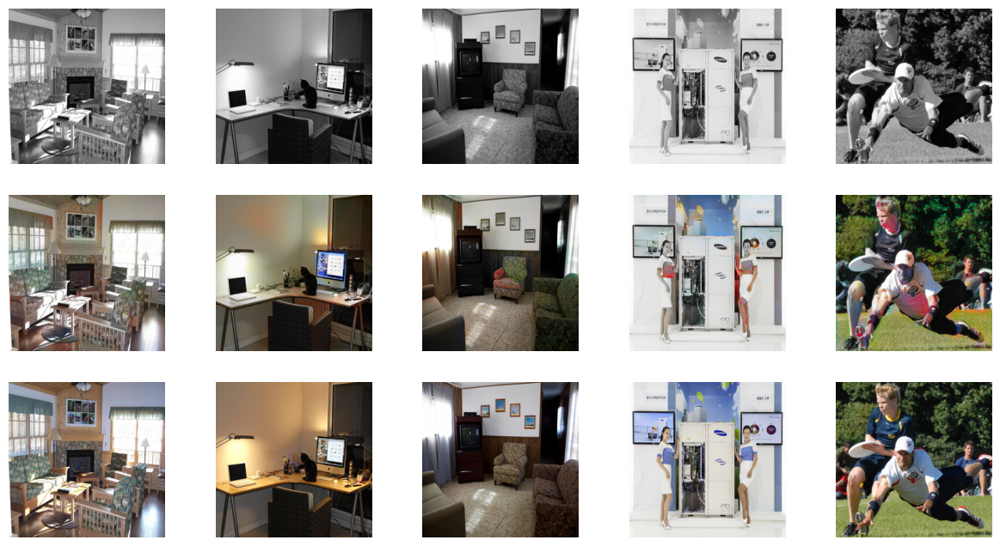


Epoch 10/20
Iteration 400/500
loss_D_fake: 0.58689
loss_D_real: 0.63057
loss_D: 0.60873
loss_G_GAN: 1.01147
loss_G_L1: 8.56185
loss_G: 9.57332


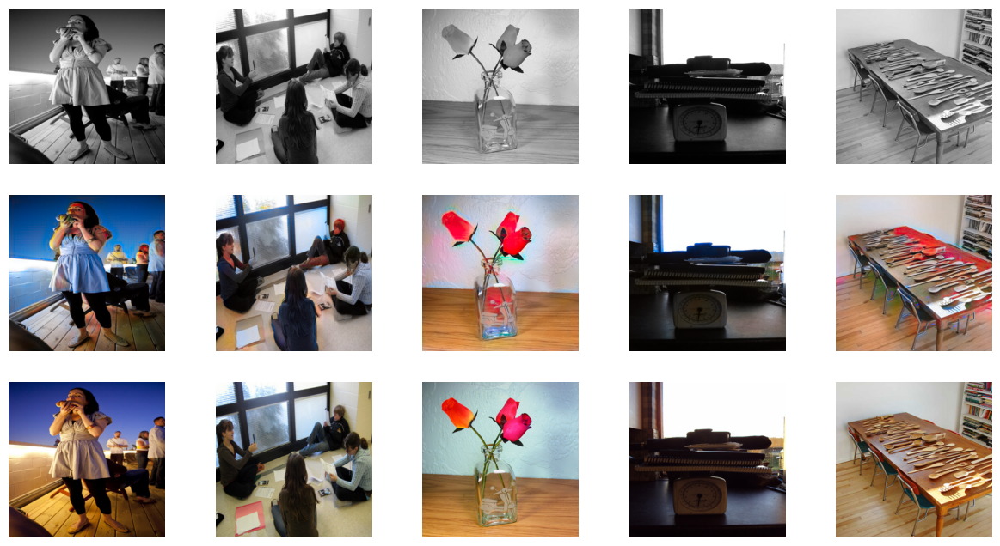

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 11/20
Iteration 200/500
loss_D_fake: 0.59053
loss_D_real: 0.63712
loss_D: 0.61383
loss_G_GAN: 1.01115
loss_G_L1: 8.40053
loss_G: 9.41169


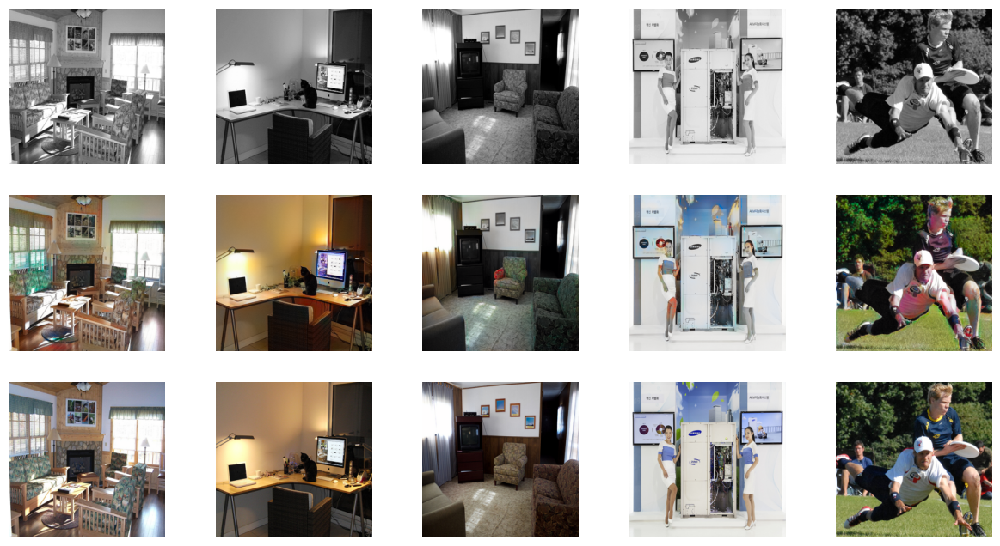


Epoch 11/20
Iteration 400/500
loss_D_fake: 0.59325
loss_D_real: 0.62805
loss_D: 0.61065
loss_G_GAN: 1.00108
loss_G_L1: 8.35813
loss_G: 9.35922


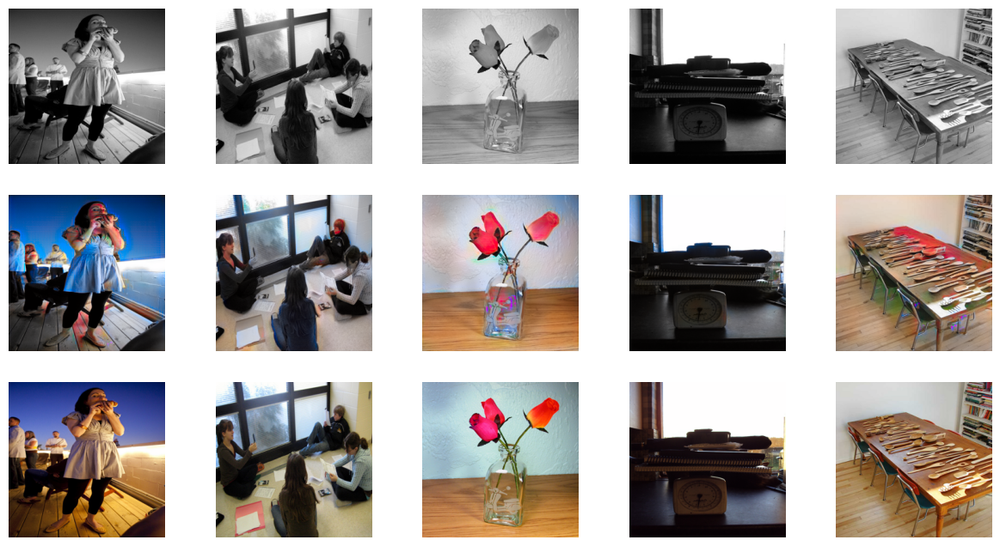

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 12/20
Iteration 200/500
loss_D_fake: 0.58955
loss_D_real: 0.63927
loss_D: 0.61441
loss_G_GAN: 1.00063
loss_G_L1: 8.26869
loss_G: 9.26932


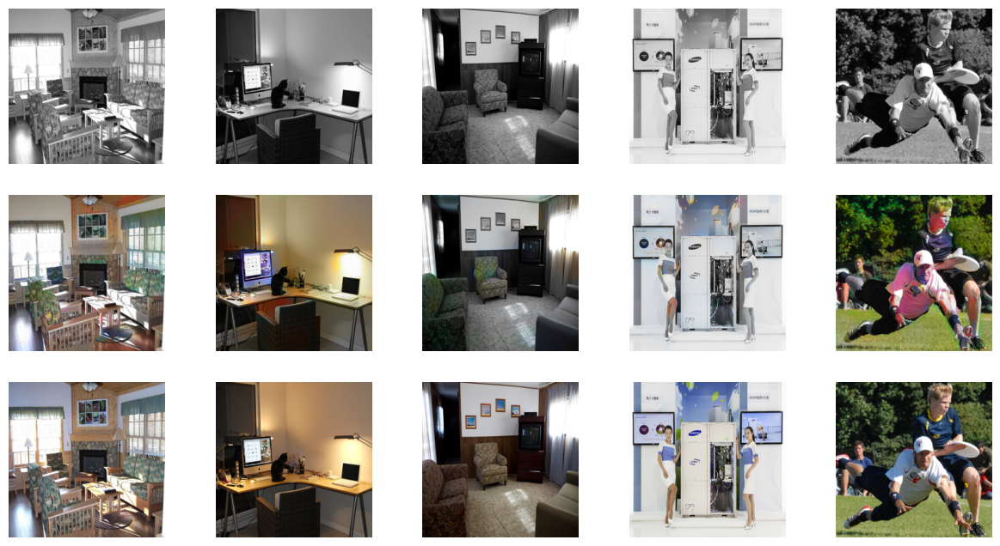


Epoch 12/20
Iteration 400/500
loss_D_fake: 0.59288
loss_D_real: 0.63307
loss_D: 0.61298
loss_G_GAN: 0.99100
loss_G_L1: 8.22053
loss_G: 9.21153


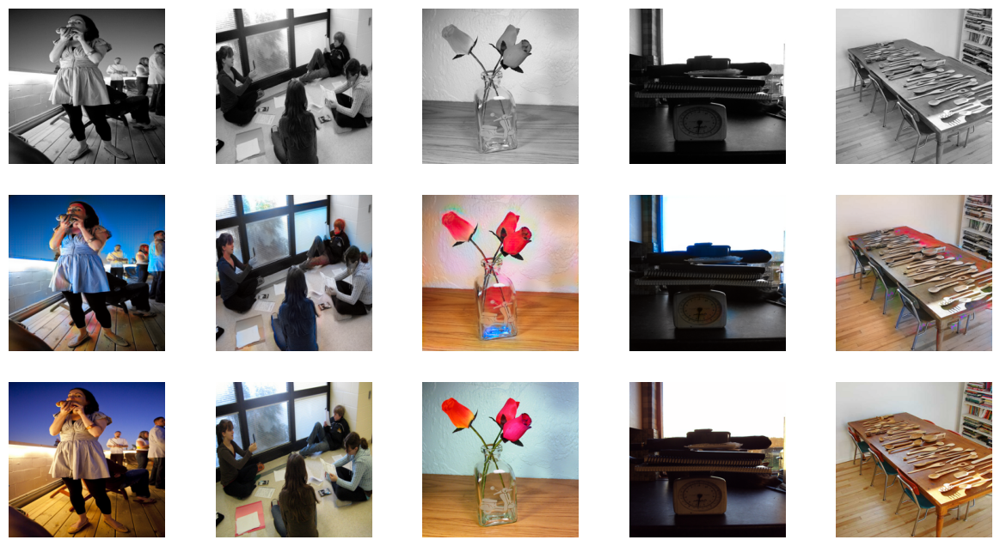

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 13/20
Iteration 200/500
loss_D_fake: 0.59264
loss_D_real: 0.63935
loss_D: 0.61600
loss_G_GAN: 0.99229
loss_G_L1: 8.09344
loss_G: 9.08573


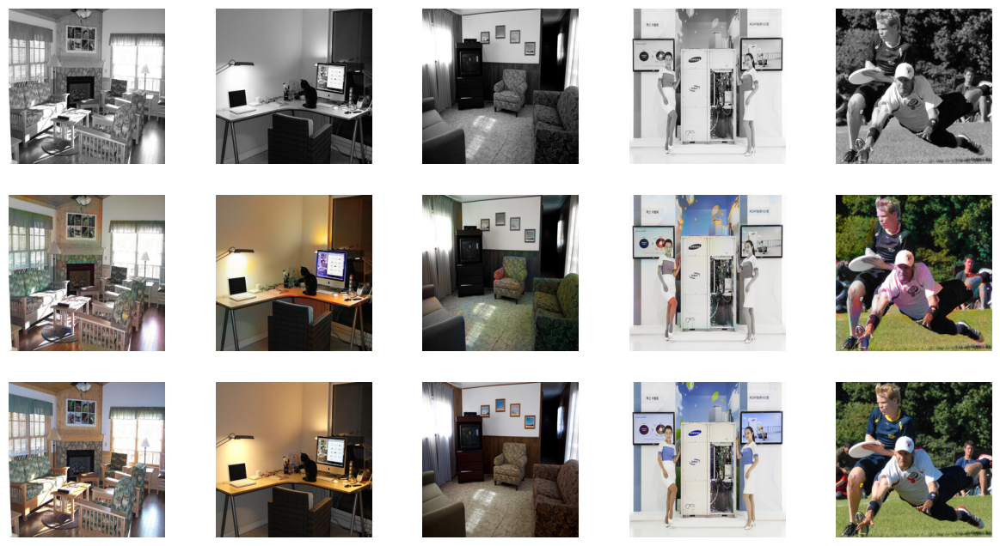


Epoch 13/20
Iteration 400/500
loss_D_fake: 0.59588
loss_D_real: 0.63395
loss_D: 0.61492
loss_G_GAN: 0.98694
loss_G_L1: 8.05632
loss_G: 9.04326


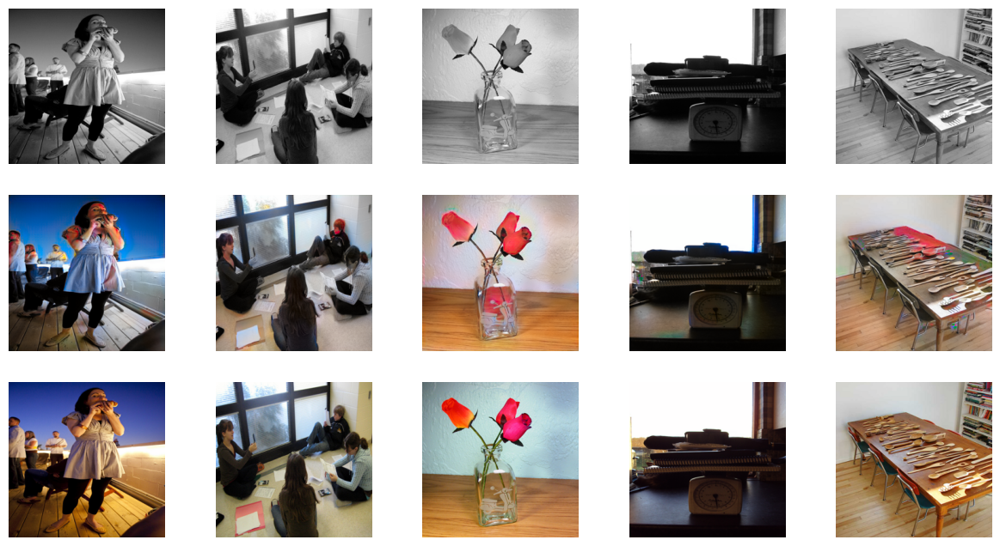

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 14/20
Iteration 200/500
loss_D_fake: 0.59856
loss_D_real: 0.64184
loss_D: 0.62020
loss_G_GAN: 0.98613
loss_G_L1: 7.93130
loss_G: 8.91743


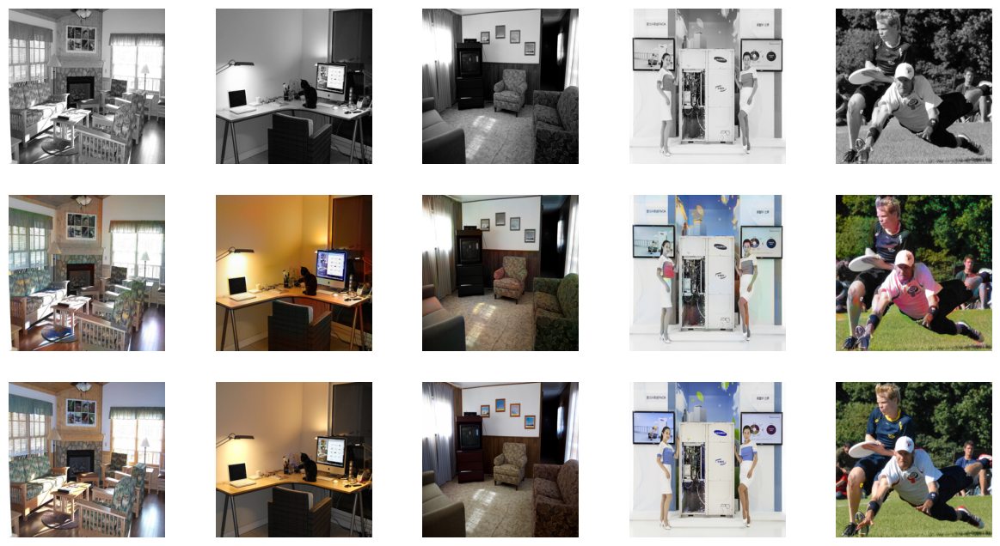


Epoch 14/20
Iteration 400/500
loss_D_fake: 0.60031
loss_D_real: 0.63216
loss_D: 0.61624
loss_G_GAN: 0.97856
loss_G_L1: 7.87100
loss_G: 8.84957


<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 44 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


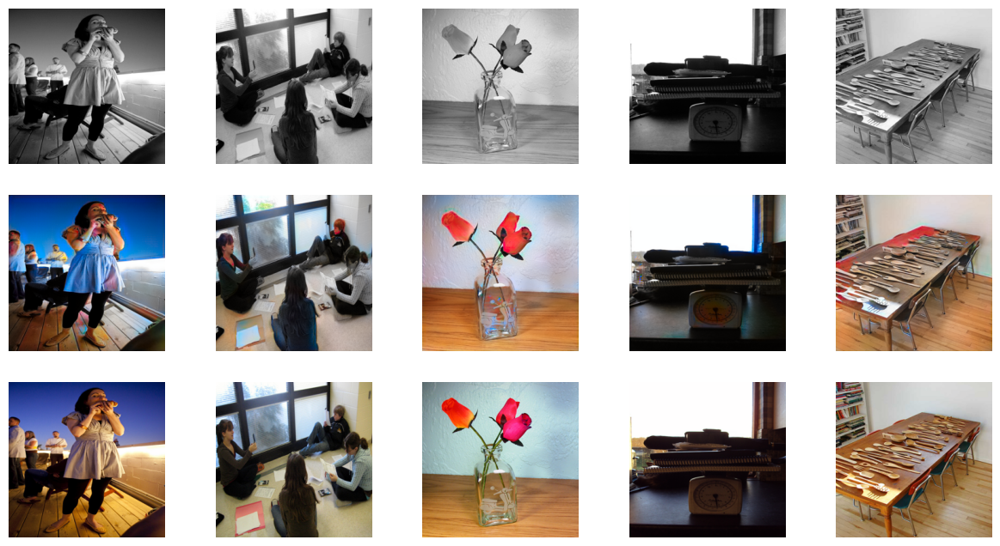

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 15/20
Iteration 200/500
loss_D_fake: 0.59625
loss_D_real: 0.64077
loss_D: 0.61851
loss_G_GAN: 0.98000
loss_G_L1: 7.77886
loss_G: 8.75885


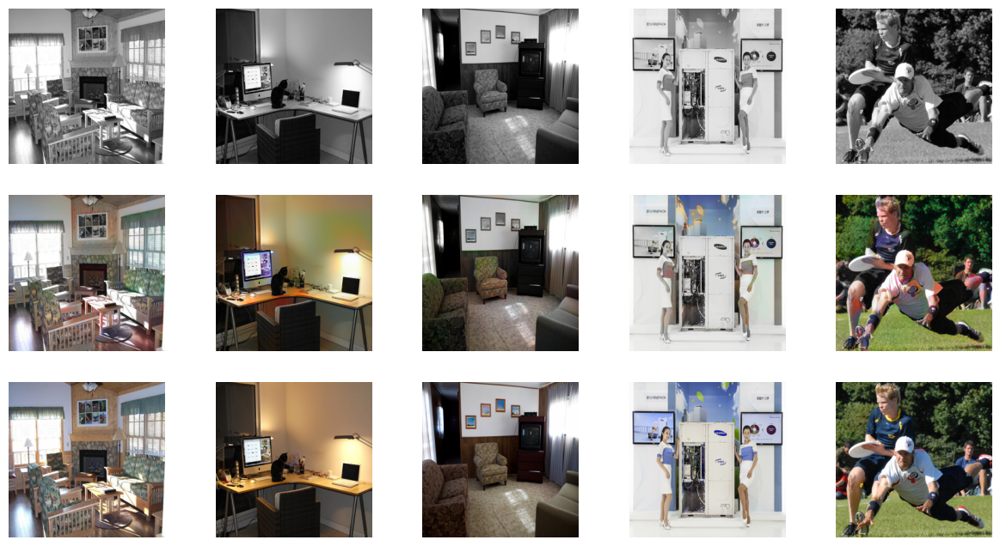


Epoch 15/20
Iteration 400/500
loss_D_fake: 0.59974
loss_D_real: 0.63333
loss_D: 0.61653
loss_G_GAN: 0.97490
loss_G_L1: 7.73213
loss_G: 8.70704


<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 30 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


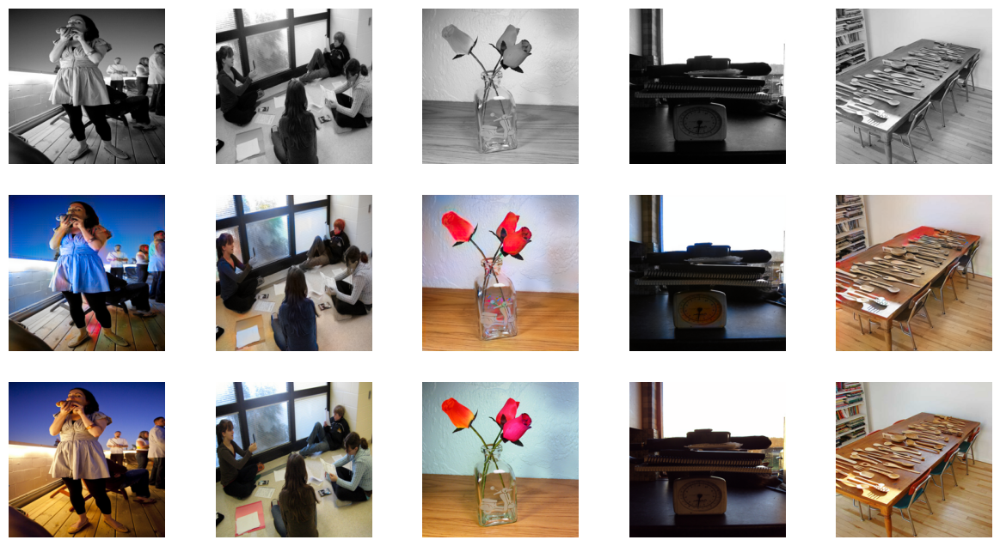

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 16/20
Iteration 200/500
loss_D_fake: 0.60222
loss_D_real: 0.63683
loss_D: 0.61953
loss_G_GAN: 0.97924
loss_G_L1: 7.57069
loss_G: 8.54993


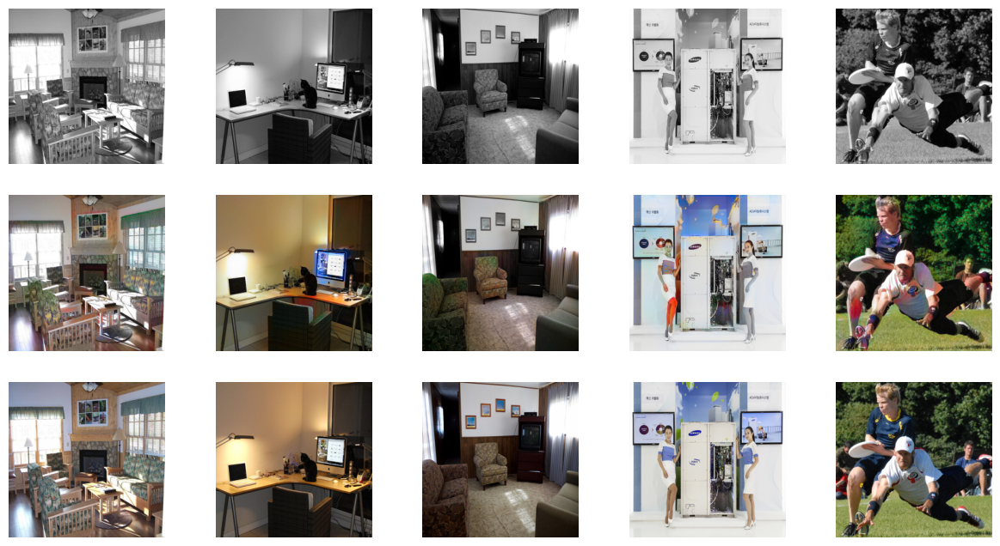


Epoch 16/20
Iteration 400/500
loss_D_fake: 0.60496
loss_D_real: 0.63186
loss_D: 0.61841
loss_G_GAN: 0.97032
loss_G_L1: 7.54965
loss_G: 8.51997


<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 70 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


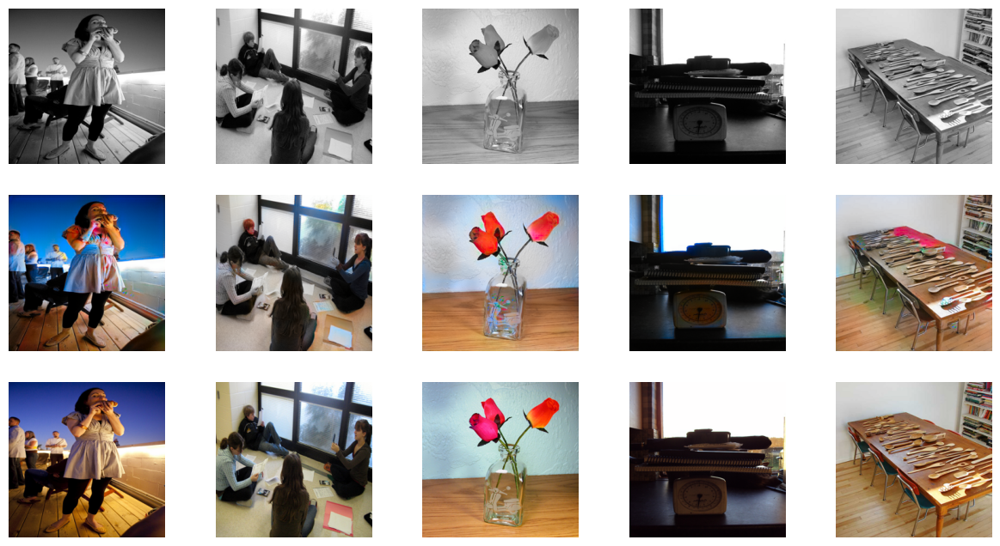

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 17/20
Iteration 200/500
loss_D_fake: 0.60091
loss_D_real: 0.63993
loss_D: 0.62042
loss_G_GAN: 0.96917
loss_G_L1: 7.47948
loss_G: 8.44865


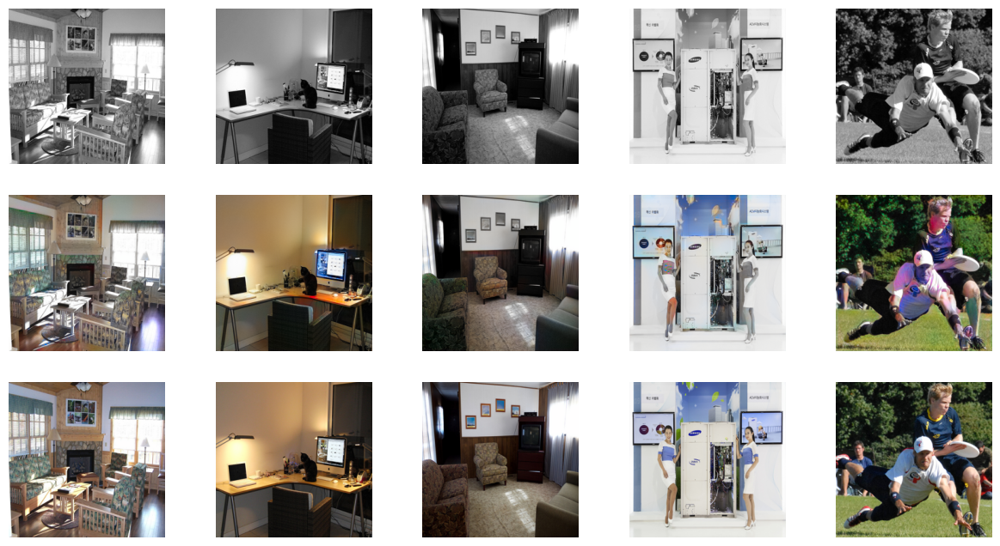


Epoch 17/20
Iteration 400/500
loss_D_fake: 0.60298
loss_D_real: 0.63182
loss_D: 0.61740
loss_G_GAN: 0.96492
loss_G_L1: 7.41347
loss_G: 8.37839


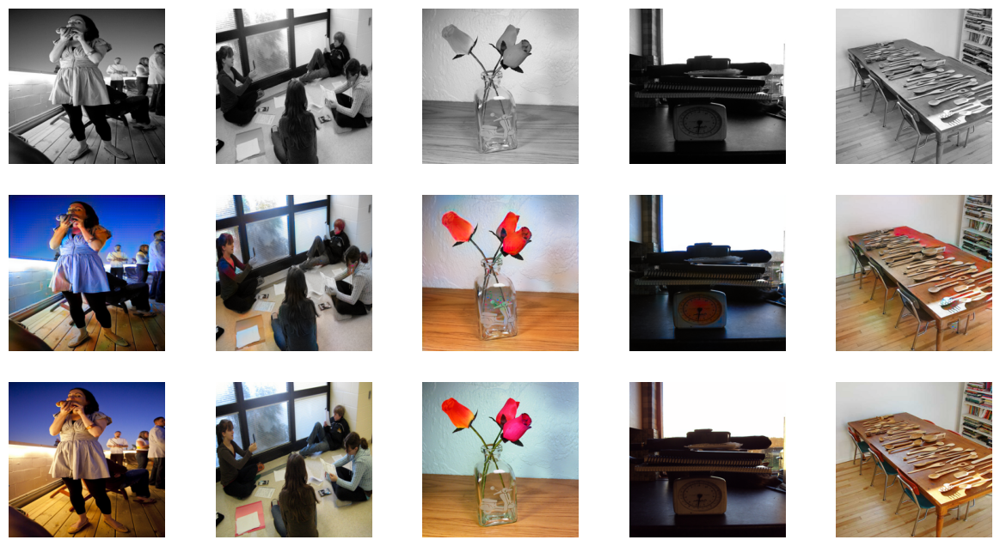

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 18/20
Iteration 200/500
loss_D_fake: 0.60640
loss_D_real: 0.63790
loss_D: 0.62215
loss_G_GAN: 0.97165
loss_G_L1: 7.31922
loss_G: 8.29087


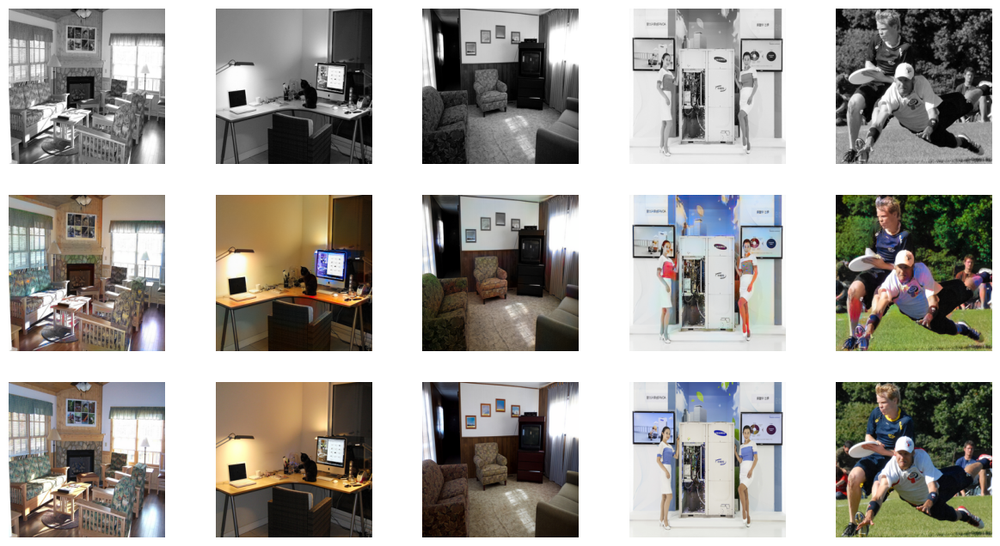


Epoch 18/20
Iteration 400/500
loss_D_fake: 0.60508
loss_D_real: 0.63415
loss_D: 0.61962
loss_G_GAN: 0.96438
loss_G_L1: 7.26954
loss_G: 8.23392


<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 8 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-30-6769f52bf0eb>:7: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 19 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


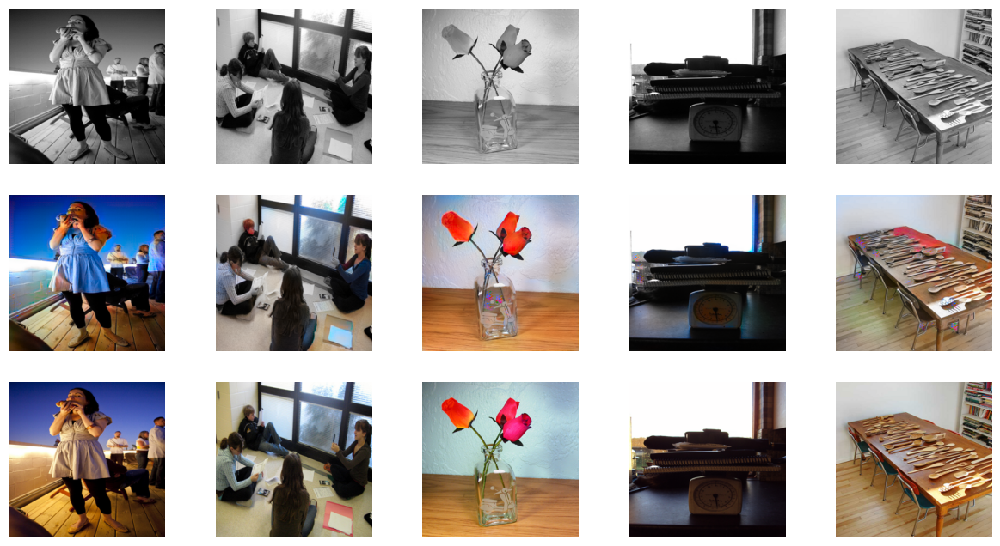

In [ ]:
net_G = build_res_unet(n_input=1, n_output=2, size=256)
net_G.load_state_dict(torch.load("res18-unet.pt", map_location=device))
model = MainModel(net_G=net_G)
train_model(model, train_dl, 5)

In [ ]:
!gdown --id 1lR6DcS4m5InSbZ5y59zkH2mHt_4RQ2KV

In [ ]:
net_G = build_res_unet(n_input=1, n_output=2, size=256)
net_G.load_state_dict(torch.load("res18-unet.pt", map_location=device))
model = MainModel(net_G=net_G)
model.load_state_dict(torch.load("final_model_weights.pt", map_location=device))

In [ ]:
net_G = build_res_unet(n_input=1, n_output=2, size=256)
model = MainModel(net_G=net_G)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.load_state_dict(
    torch.load(
        "final_model_weights.pt",
        map_location=device
    )
)

In [ ]:
test = next(iter(val_dl))

In [ ]:
plt.imshow(test["L"][0][0].cpu(), cmap="gray")

In [ ]:
model.eval()
with torch.no_grad():
    preds = model.net_G(test["L"].cpu().to(device))
colorized = lab_to_rgb(test["L"].cpu(), preds.cpu())[0]
plt.imshow(colorized)